# АиФ. Доброе сердце

**Заказчик**: Фонд «АиФ. Доброе сердце» был создан в 2005-м году по инициативе еженедельной газеты «Аргументы и факты». За эти годы больше 10 тысяч подопечных со сложными диагнозами получили помощь с оплатой операций, лекарств и медоборудования.

**Задачи:** 
- проведение RFM-анализа, 
- проведение когортного анализа (retention, LTV, средний чек).

In [1]:
# импорт необходимых библиотек
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import numpy as np

In [2]:
# доп настройки
pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', lambda x: f'{x:.2f}')
pd.options.plotting.backend = 'plotly'
plt.style.use('seaborn-v0_8-whitegrid')

### 1. Загрузка и подготовка данных

Загрузим датасет с данными о платежах и назовем его pay_info.

In [3]:
pth1 = r'C:\Users\user\practicum\dobroe_serdce\paymentsaif.csv'
pth2 = r'https://drive.google.com/file/d/1plfNlN3_nJurmDpVdxaLvAMRFoO_RhcQ/view?usp=sharing'

if os.path.exists(pth1):
    pay_info = pd.read_csv(pth1, sep=";", encoding="cp1251", 
                           usecols=[2, 5, 17, 20, 21, 30],
                           parse_dates = ['OrderFirstActionDateTimeUtc'],
                           dayfirst=True)
elif os.path.exists(pth2):
    pay_info = pd.read_csv(pth2, sep=";", encoding="cp1251", 
                           usecols=[2, 5, 17, 20, 21, 30],
                           parse_dates = ['OrderFirstActionDateTimeUtc'],
                           dayfirst=True)
else:
    print('Ошибка')

In [4]:
pay_info.info() # проверим основную информацию

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54445 entries, 0 to 54444
Data columns (total 6 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   OrderFirstActionDateTimeUtc   54445 non-null  datetime64[ns]
 1   OrderFirstActionChannelName   54445 non-null  object        
 2   OrderLineProductName          54245 non-null  object        
 3   OrderLinePriceOfLine          54445 non-null  int64         
 4   OrderLineStatusIdsExternalId  54445 non-null  object        
 5   OrderCustomerIdsMindboxId     54445 non-null  int64         
dtypes: datetime64[ns](1), int64(2), object(3)
memory usage: 2.5+ MB


Сразу назначим колонкам более удобные имена.

In [5]:
pay_info.columns = ['order_dt', 'channel_name', 'product_name', 
                    'order_sum', 'status_id', 'customer_id']
pay_info.columns

Index(['order_dt', 'channel_name', 'product_name', 'order_sum', 'status_id',
       'customer_id'],
      dtype='object')

 Какие поля были выгружены:
 - order_dt - дата и время заказа (время UTC+3),
 - channel_name - название канала, с которого выполнено пожертвование,
 - product_name - название продукта (пожертвования),
 - order_sum - сумма выбранного пожертвования,
 - status_id - идентификатор статуса заказа,
 - customer_id - идентификатор пользователя mindbox.

In [6]:
pay_info.head()

,order_dt,channel_name,product_name,order_sum,status_id,customer_id
0,2021-10-14 15:50:00,Административный сайт Mindbox,На уставную деятельность,1,Paid,2734
1,2021-03-18 10:52:00,Административный сайт Mindbox,На уставную деятельность,50,Paid,2734
2,2022-11-23 08:42:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,100,notpaid,2734
3,2023-03-29 15:15:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,300,Paid,2847
4,2021-06-16 23:10:00,Административный сайт Mindbox,На уставную деятельность,200,Paid,2847


Далее поближе познакомимся с содержанием колонок.

In [7]:
print("Каналы привлечения пользователей: " 
      f"{pay_info['channel_name'].unique()}.")

Каналы привлечения пользователей: ['Административный сайт Mindbox' 'Сайт'].


In [8]:
print("Уникальных наименований продуктов (пожертвований): " 
      f"{pay_info['product_name'].nunique()} вариантов.")

Уникальных наименований продуктов (пожертвований): 155 вариантов.


In [9]:
print("Уникальных размеров пожертвований: " 
      f"{pay_info['order_sum'].nunique()} вариантов.")

Уникальных размеров пожертвований: 657 вариантов.


In [10]:
print("Статус заказа принимает одно из 3х значений: " 
      f"{pay_info['status_id'].unique()}.")

Статус заказа принимает одно из 3х значений: ['Paid' 'notpaid' 'fail'].


In [11]:
print("Уникальных id пользователей: " 
      f"{pay_info['customer_id'].nunique()}.")

Уникальных id пользователей: 17339.


Посмотрим, что из себя представляют заказы со статусом заказа 'fail'.

In [12]:
print("По скольким уникальным наименованиям пожертвований встречается статус оплаты 'fail': " 
      f"{pay_info[pay_info['status_id'] == 'fail']['product_name'].nunique()} шт.")
pay_info[pay_info['status_id'] == 'fail'].head()

По скольким уникальным наименованиям пожертвований встречается статус оплаты 'fail': 88 шт.


,order_dt,channel_name,product_name,order_sum,status_id,customer_id
63,2022-05-30 10:30:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,500,fail,7390
64,2022-06-01 17:16:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,300,fail,7390
68,2022-09-06 10:59:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,500,fail,7390
139,2023-11-02 16:40:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,100,fail,7735
140,2023-10-31 16:39:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,100,fail,7735


Скорее всего статус заказа 'fail' не зависит от выбора продукта или стоимости выбранного пожертвования, а зависит от иных, скорее технических причин.

Также интересно посмотреть на часть данных, в которых название продукта отсутствует.

In [13]:
print("По каким каналам может пройти оплата продукта без наименования: " 
      f"{pay_info[pay_info['product_name'].isna()]['channel_name'].unique()}.")
pay_info[pay_info['product_name'].isna()].head()

По каким каналам может пройти оплата продукта без наименования: ['Сайт' 'Административный сайт Mindbox'].


,order_dt,channel_name,product_name,order_sum,status_id,customer_id
10,2022-04-21 11:16:00,Сайт,NaN,10,Paid,2861
331,2022-06-02 12:58:00,Сайт,NaN,100,Paid,8611
332,2022-04-02 12:58:00,Сайт,NaN,100,Paid,8611
333,2022-05-02 12:58:00,Сайт,NaN,100,Paid,8611
373,2022-04-21 14:58:00,Сайт,NaN,100,Paid,8764


Посмотрим насколько это распространенное явление и можем ли мы избавиться от таких данных без ущерба для исследования.

In [14]:
print("Доля данных о платежах с отсутствующем наименованием продукта: " 
      f"{(pay_info[pay_info['product_name'].isna()]['order_sum'].count() / pay_info['order_sum'].count()):.2%}")

Доля данных о платежах с отсутствующем наименованием продукта: 0.37%


Название продукта может отсутстовать как при любом канале привлечения, так и при любом статусе заказа и размере пожертвования. А доля таких платежей крайне мала.</br> + Заказчик подтвердил, что это результат технической ошибки.

Поскольку процент незначителен и пропуски не подлежат логическому заполнению - удалим эти данные.

In [15]:
pay_info = pay_info.dropna(subset = ['product_name']) 
pay_info = pay_info.reset_index(drop=True) #обновим индексы

Проверим полные дубликаты.

In [16]:
# количество
pay_info.duplicated().sum()

1599

In [17]:
# как выглядят
pay_info[pay_info.duplicated(keep=False)].sort_values(by=['customer_id', 'order_dt']).head(30)

,order_dt,channel_name,product_name,order_sum,status_id,customer_id
407,2021-05-01 00:00:00,Административный сайт Mindbox,На уставную деятельность,150,Paid,8777
414,2021-05-01 00:00:00,Административный сайт Mindbox,На уставную деятельность,150,Paid,8777
406,2021-05-02 00:00:00,Административный сайт Mindbox,На уставную деятельность,150,Paid,8777
410,2021-05-02 00:00:00,Административный сайт Mindbox,На уставную деятельность,150,Paid,8777
392,2021-05-04 00:00:00,Административный сайт Mindbox,На уставную деятельность,100,Paid,8777
411,2021-05-04 00:00:00,Административный сайт Mindbox,На уставную деятельность,100,Paid,8777
408,2021-05-10 00:00:00,Административный сайт Mindbox,На уставную деятельность,100,Paid,8777
413,2021-05-10 00:00:00,Административный сайт Mindbox,На уставную деятельность,100,Paid,8777
393,2021-05-13 00:00:00,Административный сайт Mindbox,На уставную деятельность,100,Paid,8777
418,2021-05-13 00:00:00,Административный сайт Mindbox,На уставную деятельность,100,Paid,8777


In [18]:
print("Процент дубликатов: " 
      f"{(pay_info.duplicated().sum() / pay_info['order_dt'].count()):.2%}")

Процент дубликатов: 2.95%


Если бы мы загрузили столбец с id транзакций, то увидели бы, что они прошли под разными номерами, так что оставим эти дубликаты.

Добавим в таблицу колонку с датой, отбросив время.

In [19]:
pay_info['order_date'] = pay_info['order_dt'].dt.date
pay_info['order_date'] = pay_info['order_date'].astype('datetime64[ns]')

А также добавим колонку с данными о количестве дней активности каждого пользователя.

In [20]:
pay_info['period'] = (pay_info.groupby('customer_id')['order_date']
                      .transform(lambda x: int((x.max() - x.min()) / pd.Timedelta('1d')) + 1)
                     )

In [21]:
pay_info.head()

,order_dt,channel_name,product_name,order_sum,status_id,customer_id,order_date,period
0,2021-10-14 15:50:00,Административный сайт Mindbox,На уставную деятельность,1,Paid,2734,2021-10-14,616
1,2021-03-18 10:52:00,Административный сайт Mindbox,На уставную деятельность,50,Paid,2734,2021-03-18,616
2,2022-11-23 08:42:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,100,notpaid,2734,2022-11-23,616
3,2023-03-29 15:15:00,Сайт,Пожертвование Благотворительный фонд «АиФ. Доб...,300,Paid,2847,2023-03-29,652
4,2021-06-16 23:10:00,Административный сайт Mindbox,На уставную деятельность,200,Paid,2847,2021-06-16,652


### 2. Исследовательский анализ данных

Мы познакомились с имеющимися данными, а теперь оставим только те, которые нужны нам для анализа, а конкретно только оплаченные заказы.

In [22]:
paid = pay_info.copy() # скопируем данные в новый датафрейм

In [23]:
paid = paid[paid['status_id'] == 'Paid'] # оставим только оплаченные заказы

In [24]:
print("Процент неоплаченных заказов в датафрейме (notpaid и fail): " 
      f"{(1 - paid['status_id'].count() / pay_info['status_id'].count()):.2%}")

Процент неоплаченных заказов в датафрейме (notpaid и fail): 24.50%


В качестве даты анализа будем использовать максимально возможный день в имеющихся данных +1.

In [25]:
now = paid['order_date'].max() + pd.Timedelta('1d')
now

Timestamp('2023-11-10 00:00:00')

Посмотрим на распределение непрерывных признаков.

In [26]:
paid[['order_date','order_sum']].describe()

,order_date,order_sum
count,40956,40956.00
mean,2022-09-16 09:43:24.277761792,762.60
min,2021-01-01 00:00:00,1.00
25%,2022-01-27 00:00:00,150.00
50%,2022-10-05 00:00:00,300.00
75%,2023-06-02 00:00:00,500.00
max,2023-11-09 00:00:00,200000.00
std,NaN,2725.95


Здесь видно, что мы имеем данные о платежах за период с 2021-01-01 по 2023-11-09.<br>
А также можно обратить внимание на распределение размеров пожертвований.<br>
Медианная сумма пожертвования составляет 300 рублей, в основном люди жертвуют в диапазоне 150-500 рублей. Максимальный единоразовый взнос составляет 200 000 рублей.<br>

Посмотрим на графике как платежи распределены во времени, сумму в расчет не берем, просто смотрим количество совершенных платежей.

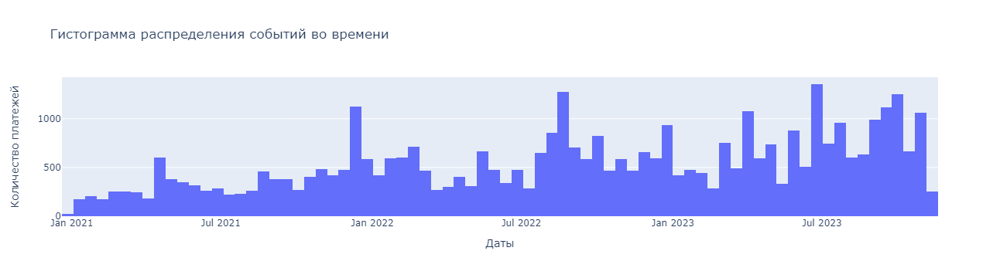

In [27]:
fig = px.histogram(paid, x="order_date",
                  title='Гистограмма распределения событий во времени')
fig.update_layout(xaxis_title='Даты', yaxis_title='Количество платежей')
fig.show()

Большой всплеск активности наблюдается с 2021-12-05 по 2021-12-18, возможно, была какая-нибудь предновогодняя рассылка, на которую пользователи хорошо отреагировали. Начиная с июля 2022 таких всплесков больше и пользователи в целом более активны.

Теперь построим график, на котором посмотрим каков период активности пользователей.

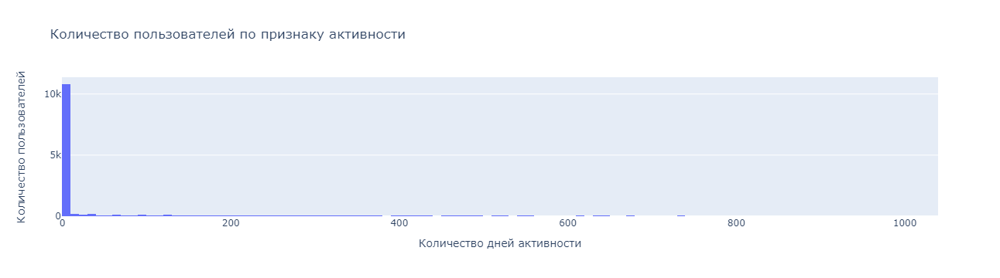

In [28]:
fig = px.histogram(paid.groupby('customer_id')['period'].last(), x="period",
                   title='Количество пользователей по признаку активности')
fig.update_layout(xaxis_title='Количество дней активности', yaxis_title='Количество пользователей')
fig.show()

In [29]:
paid[paid['period'] == 1]['customer_id'].nunique()

10520

In [30]:
paid[paid['period'] == 1]['customer_id'].nunique() / paid['customer_id'].nunique()

0.687401986408782

Действительно много пользователей совершивших пожертвование единожды (10 520 человек - это 69% от общего числа пользователей), поэтому и на графике мы видим всплеск около этого значения. Посмотрим на график, исключив таких пользователей.

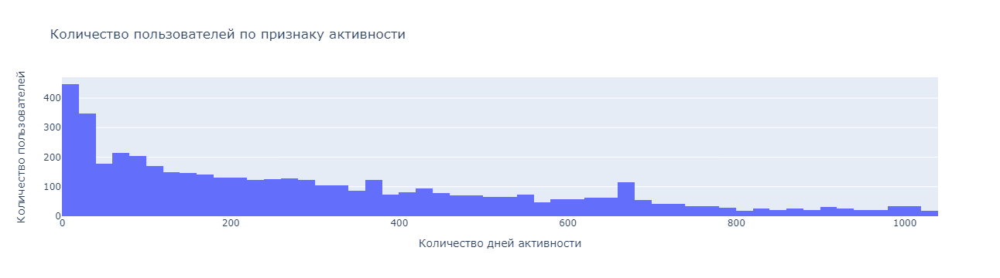

In [31]:
fig = px.histogram(paid[paid['period'] > 1].groupby('customer_id')['period'].last(), x="period",
                   title='Количество пользователей по признаку активности')
fig.update_layout(xaxis_title='Количество дней активности', yaxis_title='Количество пользователей')
fig.show()

Закономерно можно увидеть, что чем больше период активности - тем меньше таких пользователей.

Посмотрим как нам для удобства укоротить названия пожертвований.

In [32]:
paid['product_name'].unique()

array(['На уставную деятельность',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Ратмир Шаповалов',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Эвелина Квасова',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Максим Широкин',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Дарья Макеева',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Иван Нагорный',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Кира Чубарова',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Руслан Сафронов',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Кристина Шабетник',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Никита Суриков',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Снежана О.',
       'Пожертвование Благотворительный фонд «АиФ. Доброе сердце» Кристина Разживина',
       'Пожертвование Благотворительный фонд «Аи

В названиях пожертвований удалим стандартную фразу и объединим две строчки с одинаковым по сути пожертвованием 'На уставную деятельность'.

In [33]:
paid['product_name'] = paid['product_name'].str.replace('Пожертвование Благотворительный фонд «АиФ. Доброе сердце» ', '')
paid['product_name'] = paid['product_name'].str.replace('Пожертвование на уставную деятельность БФ «АиФ. Доброе сердце»', 'На уставную деятельность')

Посмотрим на топ-15 пожертвований, которые выбирали пользователи (не учитываем размер пожертвований).

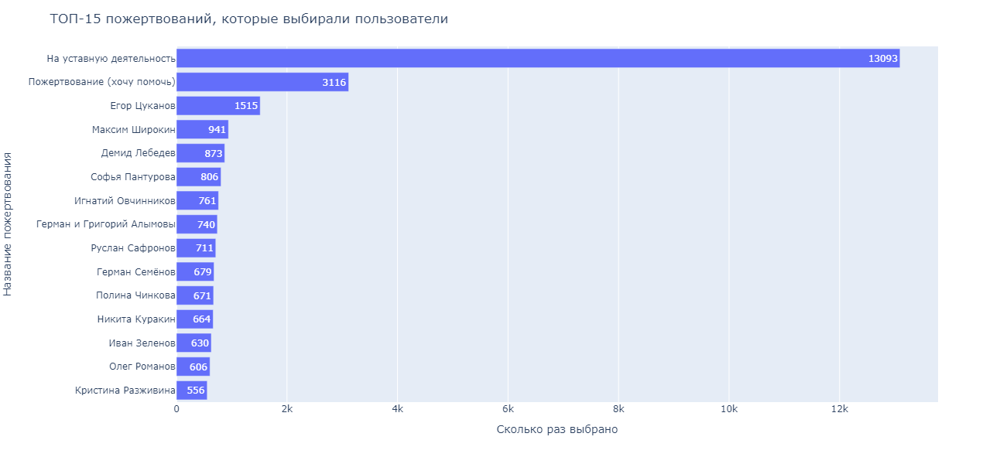

In [34]:
# готовим данные для графика
top15_product = pd.DataFrame(paid['product_name'].value_counts().head(15)).reset_index()
# строим столбчатую диаграмму 
fig = px.bar(top15_product.sort_values(by='count', ascending=True), # загружаем данные и заново их сортируем
             x='count', 
             y='product_name', 
             text='count',
             height=600 
            )
# оформляем график
fig.update_layout(title='ТОП-15 пожертвований, которые выбирали пользователи',
                   xaxis_title='Сколько раз выбрано',
                   yaxis_title='Название пожертвования')
fig.show() # выводим график

Чаще всего люди выбирают пожертвование на уставную деятельность (оно было выбрано 13 тысяч раз), далее по популярности пожертвование "хочу помочь" (3 тысячи раз).

Теперь посмотрим в разрезе собранных средств.

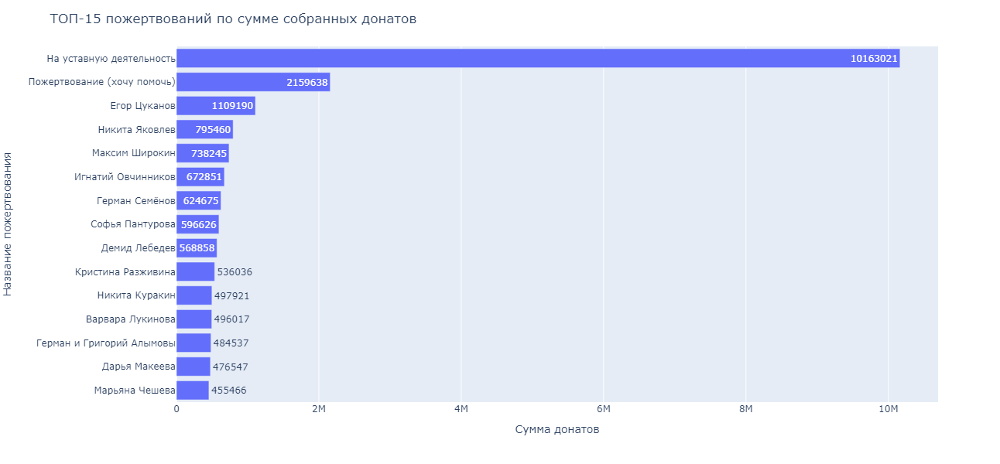

In [35]:
top15_sum = (paid.groupby(['product_name'], as_index = False)[['order_sum']]
             .sum().sort_values(by='order_sum', ascending=False).head(15)
            )
fig = px.bar(top15_sum.sort_values(by='order_sum', ascending=True),
             x='order_sum',
             y='product_name',
             text='order_sum',
             height=600
            )
fig.update_layout(title='ТОП-15 пожертвований по сумме собранных донатов',
                   xaxis_title='Сумма донатов',
                   yaxis_title='Название пожертвования')
fig.show()

Здесь ситуация схожа, но на некоторых людей жертвовали б`ольшие суммы меньшее количество раз и наоборот.

### 3. RFM-анализ

Посчитаем R, F, M для каждого пользователя.

In [36]:
# давность (R) как количество дней с момента последней покупки
paid['R_value'] = paid.groupby('customer_id')['order_date'].transform(lambda x: (now - x.max()).days)

In [37]:
# частота (F) как общее количество транзакций за период активности
paid['F_value'] = paid.groupby('customer_id')['customer_id'].transform('count') / paid['period']

In [38]:
# деньги (М) как общая сумма потраченных денег
paid['M_value'] = paid.groupby('customer_id')['order_sum'].transform('sum')

##### Давность (R)

Посмотрим на распределение значения давности.

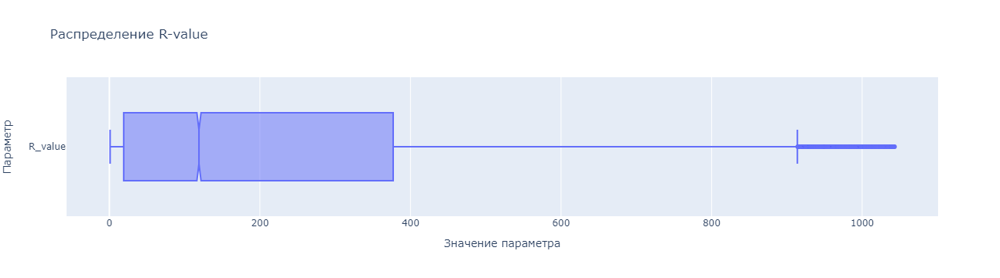

In [39]:
paid['R_value'].plot(kind='box',
                     notched=True,
                     orientation='h',
                     title='Распределение R-value',
                     labels={'variable':'Параметр', 'value': 'Значение параметра'})

Значения R-value содержит выбросы, временно избавимся от них через интерквартильный размах.

In [40]:
# q1, q3 здесь и далее это 25 и 75 перцентили
qr_1, qr_3 = np.percentile(paid['R_value'], [25, 75])

In [41]:
# интерквартильный размах это разница между 75 и 25 перцентилями
iqr_r = qr_3 - qr_1

In [42]:
# устанавливаем верхнюю границу для выбросов: 75 перцентиль + полтора интерквартильных размаха
r_top = qr_3 + iqr_r * 1.5

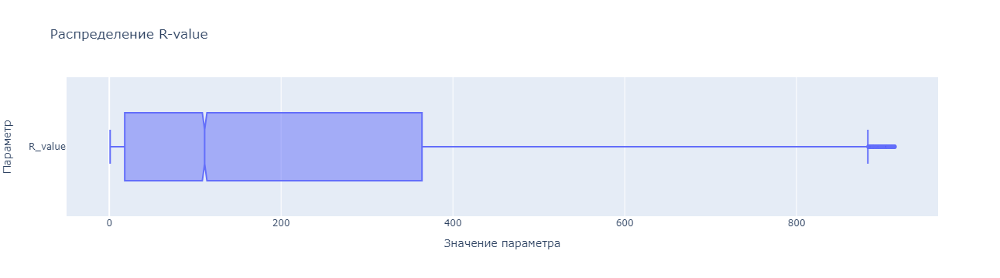

In [43]:
paid.query('R_value <= @r_top')['R_value'].plot(kind='box',
                                                notched=True,
                                                orientation='h',
                                                title='Распределение R-value',
                                                labels={'variable':'Параметр', 'value': 'Значение параметра'})

Делить на три равных интервала будем как раз по данным без выбросов.

In [44]:
pd.qcut(paid.query('R_value <= @r_top')['R_value'], 3).unique()

[(295.0, 914.0], (32.0, 295.0], (0.999, 32.0]]
Categories (3, interval[float64, right]): [(0.999, 32.0] < (32.0, 295.0] < (295.0, 914.0]]

Но данные с выбросами не отсекаем, а вписываем их также в высчитанные границы (в качестве верхней границы - максимум по столбцу).

In [45]:
r_bins = [0, 32, 295, paid['R_value'].max()]
r_labels = [3, 2, 1]

In [46]:
paid['R'] = pd.cut(paid['R_value'], bins=r_bins, labels=r_labels)

##### Частота (F)

Посмотрим на распределение значения частоты.

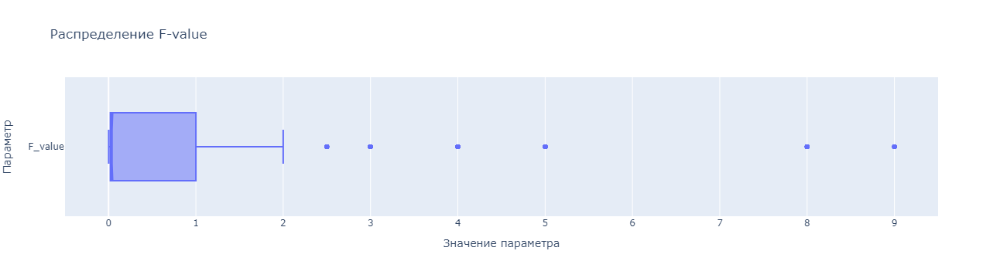

In [47]:
paid['F_value'].plot(kind='box',
                     notched=True,
                     orientation='h',
                     title='Распределение F-value',
                     labels={'variable':'Параметр', 'value': 'Значение параметра'})

Значения F-value содержат в себе выбросы, временно избавимся от них через интерквартильный размах.

In [48]:
qf_1, qf_3 = np.percentile(paid['F_value'], [25, 75])

In [49]:
iqr_f = qf_3 - qf_1

In [50]:
f_top = qf_3 + iqr_f * 1.5

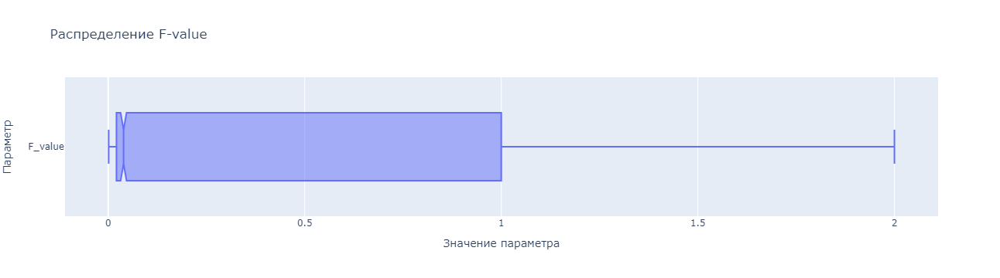

In [51]:
paid.query('F_value <= @f_top')['F_value'].plot(kind='box',
                                                notched=True,
                                                orientation='h',
                                                title='Распределение F-value',
                                                labels={'variable':'Параметр', 'value': 'Значение параметра'})

In [52]:
pd.qcut(paid.query('F_value <= @f_top')['F_value'], 3).unique()

[(0.00030999999999999995, 0.0257], (0.102, 2.0], (0.0257, 0.102]]
Categories (3, interval[float64, right]): [(0.00030999999999999995, 0.0257] < (0.0257, 0.102] < (0.102, 2.0]]

In [53]:
f_bins = [0, .026, .102, paid['F_value'].max()]
f_labels = [1, 2, 3]

In [54]:
paid['F'] = pd.cut(paid['F_value'], bins=f_bins, labels=f_labels)

##### Деньги (М)

Посмотрим на распределение значения денег.

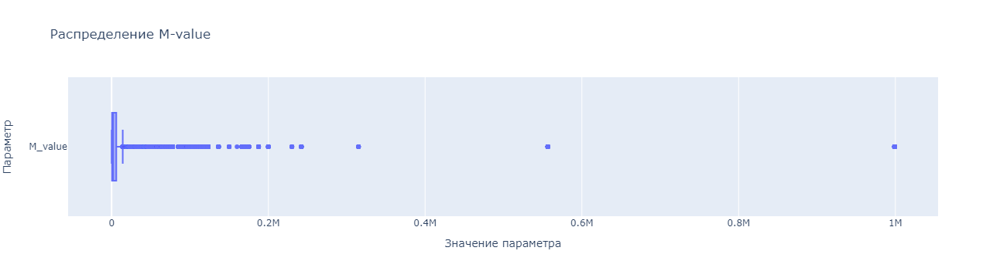

In [55]:
paid['M_value'].plot(kind='box',
                     notched=True,
                     orientation='h',
                     title='Распределение M-value',
                     labels={'variable':'Параметр', 'value': 'Значение параметра'})

Здесь также выбросы почистим через интерквартильный размах.

In [56]:
qm_1, qm_3 = np.percentile(paid['M_value'], [25, 75])

In [57]:
iqr_m = qm_3 - qm_1

In [58]:
m_top = qm_3 + iqr_m * 1.5

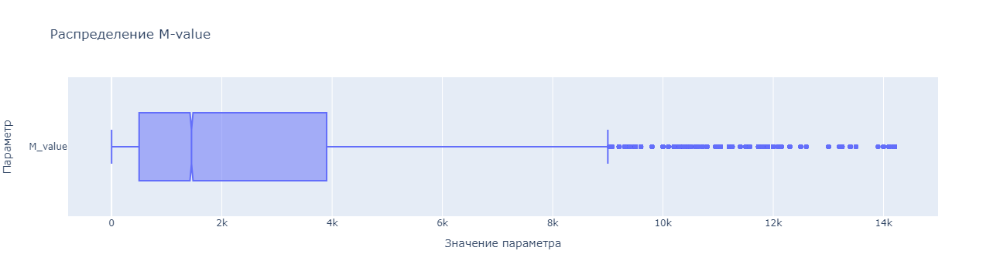

In [59]:
paid.query('M_value <= @m_top')['M_value'].plot(kind='box',
                                                notched=True,
                                                orientation='h',
                                                title='Распределение M-value',
                                                labels={'variable':'Параметр', 'value': 'Значение параметра'})

Делим на три равных интервала.

In [60]:
pd.qcut(paid.query('M_value <= @m_top')['M_value'], 3).unique()

[(0.999, 600.0], (2800.0, 14200.0], (600.0, 2800.0]]
Categories (3, interval[float64, right]): [(0.999, 600.0] < (600.0, 2800.0] < (2800.0, 14200.0]]

In [61]:
m_bins = [-0.1, 600, 2800, paid['M_value'].max()]
m_labels = [1, 2, 3]

In [62]:
paid['M'] = pd.cut(paid['M_value'], bins=m_bins, labels=m_labels)

##### Столбец с сегментами RFM

In [63]:
paid['RFM'] = paid['R'].astype('str') + paid['F'].astype('str') + paid['M'].astype('str')

Какие столбцы по итогу получили:

In [64]:
paid.head()

,order_dt,channel_name,product_name,order_sum,status_id,customer_id,order_date,period,R_value,F_value,M_value,R,F,M,RFM
0,2021-10-14 15:50:00,Административный сайт Mindbox,На уставную деятельность,1,Paid,2734,2021-10-14,616,757,0.00,51,1,1,1,111
1,2021-03-18 10:52:00,Административный сайт Mindbox,На уставную деятельность,50,Paid,2734,2021-03-18,616,757,0.00,51,1,1,1,111
3,2023-03-29 15:15:00,Сайт,Ратмир Шаповалов,300,Paid,2847,2023-03-29,652,226,0.00,500,2,1,1,211
4,2021-06-16 23:10:00,Административный сайт Mindbox,На уставную деятельность,200,Paid,2847,2021-06-16,652,226,0.00,500,2,1,1,211
5,2021-09-20 14:29:00,Административный сайт Mindbox,На уставную деятельность,25,Paid,2861,2021-09-20,632,338,0.01,110,1,1,1,111


RFM здесь - сегмент пользователя. Метрики расчитывались следующим образом: 1 - плохо, 2 - нормально, 3 - хорошо.</br>

R - recency: 
- 1 - последнее пожертвование сделано давно (больше 295 дней назад), 
- 2 - пожертвование было совершено в промежутке от 32 до 295 дней назад, 
- 3 - совершил пожертвование недавно (менее 32 дней назад);

F - frequency: 
- 1 - делает пожертвование не часто (не более 1 раза за 38 дней), 
- 2 - средняя активность (1 пожертвование в течение 10 - 38 дней), 
- 3 - высокая активность (чаще 1 раза в 10 дней);

M - monetary: 
- 1 - небольшая общая сумма пожертвований (до 600 рублей за все время), 
- 2 - средняя сумма (600-2800 рублей), 
- 3 - большая сумма (более 2800 рублей).

Посмотрим на статистику по сегментам.

In [65]:
rfm_stats = (paid.groupby('RFM')
             .agg({'customer_id':'nunique', 'order_sum': ['count', 'mean', 'sum'], 'period':'mean', 'product_name':pd.Series.mode})
             .reset_index()
            )

In [66]:
rfm_stats.columns = ['RFM сегмент', 'Человек в сегменте (чел.)', 'Количество пожертвований (ед.)', 
                     'Среднее пожертвование (руб.)', 'Сумма пожертвований (руб.)', 
                     'Средний период активности (дней)', 'Самое популярное пожертвование']

In [67]:
rfm_stats.set_index('RFM сегмент').style.format(thousands='.', decimal=',', precision=2).bar(cmap='PuBu')

,Человек в сегменте (чел.),Количество пожертвований (ед.),Среднее пожертвование (руб.),Сумма пожертвований (руб.),Средний период активности (дней),Самое популярное пожертвование
RFM сегмент,,,,,,
111,343,661,"171,98",113.680,"268,87",На уставную деятельность
112,299,977,"412,97",403.467,"376,10",На уставную деятельность
113,136,753,"2.125,38",1.600.410,"486,89",На уставную деятельность
121,216,657,"121,22",79.641,"163,98",На уставную деятельность
122,255,1.513,"237,24",358.951,"335,34",На уставную деятельность
123,161,1.908,"1.044,56",1.993.028,"523,08",На уставную деятельность
131,5.157,5.370,"289,67",1.555.519,"1,73",На уставную деятельность
132,1.297,1.567,"991,30",1.553.365,"6,29",На уставную деятельность
133,419,822,"4.771,36",3.922.060,"109,43",На уставную деятельность


Напишем функцию, чтобы смотреть id пользователей любого сегмента.

In [68]:
def customer_id(rfm):
    return paid[paid['RFM'] == rfm]['customer_id'].unique()

В скобках можно указывать необходимый rfm-сегмент, я выведу id пользователей из сегмента "333".

In [69]:
customer_id('333')

array([17387, 22683, 25093, 25737, 33331, 34862, 35303, 35527, 35737,
       37660, 38178, 38457, 39227, 39397, 39828, 40099, 41877, 42006,
       42038, 42039, 42066, 42119, 42179, 42195, 42220, 42221, 42222,
       42223, 42229, 42231, 42233, 42261, 42268, 42272, 42274, 42307,
       42315, 42316, 42317, 42319, 42320, 42334, 42341, 42343, 42346,
       42363, 42380, 42382, 42397, 42403, 42425], dtype=int64)

### 4. Когортный анализ

Создадим таблицу с профилями пользователей. Мы берем в анализ только ту часть данных, в которой заказы являются оплаченными.

In [70]:
def get_profiles(donations):

    # сортируем донаты по ID пользователя и дате первого доната
    # группируем по ID и находим первое значение order_date
    # столбец с датой первого доната назовём first_donation
    profiles = (
        donations.sort_values(by=['customer_id', 'order_date'])
        .groupby('customer_id')
        .agg({'order_date':'first', 'channel_name':'first'})
        .rename(columns={'order_date':'first_donation', 'channel_name':'first_channel'})
        .reset_index()
    )

    # определяем первый день месяца, в который этот донат был сделан
    # эти и будет когортой каждого пользователя
    profiles['cohort'] = profiles['first_donation'].to_numpy().astype('datetime64[M]')

    return profiles

In [71]:
profiles = get_profiles(paid)
profiles.head()

,customer_id,first_donation,first_channel,cohort
0,2734,2021-03-18,Административный сайт Mindbox,2021-03-01
1,2847,2021-06-16,Административный сайт Mindbox,2021-06-01
2,2861,2021-03-16,Административный сайт Mindbox,2021-03-01
3,3361,2022-12-20,Сайт,2022-12-01
4,4982,2021-01-01,Административный сайт Mindbox,2021-01-01


In [72]:
profiles.nunique()

customer_id       15304
first_donation     1002
first_channel         2
cohort               35
dtype: int64

Все верно, получилось 15 304 профилей пользователей и 35 когорт (начиная с 2021-01-01 и заканчивая 2023-11-01).

Построим график, чтобы посмотреть как распределились пользователи по когортам.

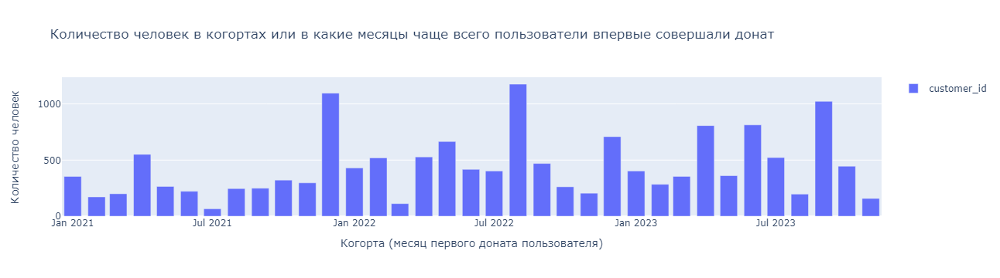

In [73]:
fig = px.bar(profiles.groupby('cohort')['customer_id'].count(),
            title='Количество человек в когортах или в какие месяцы чаще всего пользователи впервые совершали донат',
            labels={'cohort':'Когорта (месяц первого доната пользователя)', 'value': 'Количество человек'})
fig.update_layout(legend=None)
fig.show()

Самые популярные месяцы, в которые люди впервые совершали донат - это декабрь 2021, август 2022 и сентябрь 2023.

Посмотрим на график с каналом первого доната пользователей.

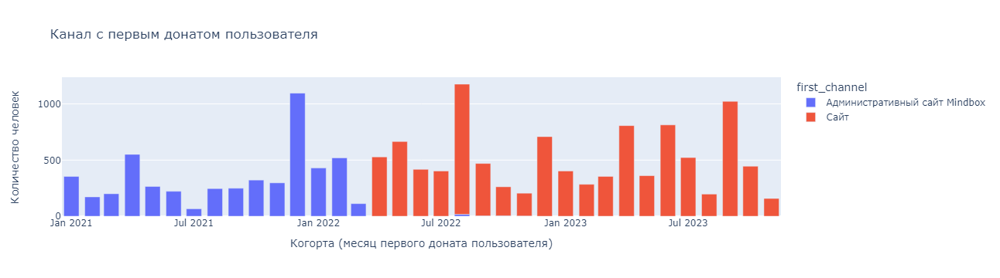

In [74]:
fig = px.bar(profiles.pivot_table(index=['cohort', 'first_channel'], values='customer_id', aggfunc='count').reset_index(), 
             x='cohort', y='customer_id', color='first_channel',
             title='Канал с первым донатом пользователя',
             labels={'cohort':'Когорта (месяц первого доната пользователя)', 'customer_id': 'Количество человек'})
fig.show()

Похоже, что до апреля 2022 это административный сайт Mindbox, а после - почти всегда сайт. Заказчик скорее всего знает с чем это связано.

Теперь к профилям пользователей присоединим данные об оплаченных заказах.

In [75]:
# присоединяем paid к профилям по столбцу customer_id
result_raw = profiles.merge(
    paid[['customer_id', 'order_date', 'order_sum', 'period']], on='customer_id', how='left'
)
result_raw.head()

,customer_id,first_donation,first_channel,cohort,order_date,order_sum,period
0,2734,2021-03-18,Административный сайт Mindbox,2021-03-01,2021-10-14,1,616
1,2734,2021-03-18,Административный сайт Mindbox,2021-03-01,2021-03-18,50,616
2,2847,2021-06-16,Административный сайт Mindbox,2021-06-01,2023-03-29,300,652
3,2847,2021-06-16,Административный сайт Mindbox,2021-06-01,2021-06-16,200,652
4,2861,2021-03-16,Административный сайт Mindbox,2021-03-01,2021-09-20,25,632


Построим график, чтобы посмотреть какую сумму донатов принесла каждая когорта за все время.

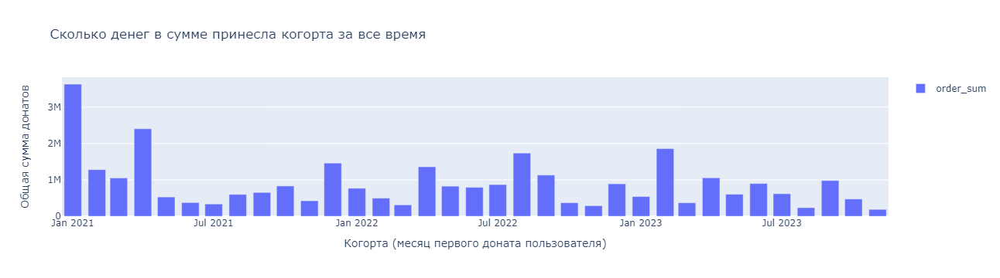

In [76]:
fig = px.bar(result_raw.groupby('cohort')['order_sum'].sum(),
            title='Сколько денег в сумме принесла когорта за все время',
            labels={'cohort':'Когорта (месяц первого доната пользователя)', 'value': 'Общая сумма донатов'})
fig.update_layout(legend=None)
fig.show()

Лидер донатов - самая первая когорта января 2021, но не стоит забывать, что она и существует дольше остальных. На втором месте - апрельская когорта 2021.

Также посмотрим на среднеарифметические и медианы сумм пожертвований (средний чек) по когортам.

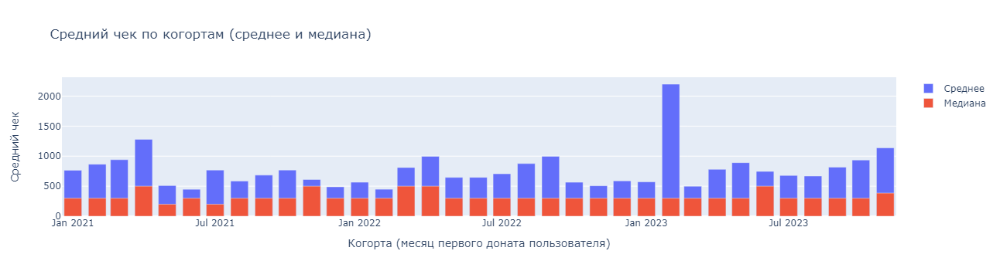

In [77]:
average_bill = result_raw.pivot_table(index='cohort', values='order_sum', aggfunc=['mean','median']).reset_index()
average_bill.columns = ['cohort', 'mean', 'median']

go_fig = go.Figure()
obj1 = go.Bar(name="Среднее", x=average_bill['cohort'], y=average_bill['mean'])
obj2 = go.Bar(name="Медиана", x=average_bill['cohort'], y=average_bill['median'])

go_fig.add_trace(obj1)
go_fig.add_trace(obj2)

go_fig.update_layout(barmode='overlay', title_text='Средний чек по когортам (среднее и медиана)',
                    xaxis_title='Когорта (месяц первого доната пользователя)', yaxis_title='Средний чек')

go_fig.show()

Как мы и заметили ранее, медианное значение пожертвований в основном 300 рублей. А среднее всегда выше. Особенно выделяется когорта февраля 2023, где среднее равно довольно высокому значению 2 198 рублей.

Вычисляем лайфтайм для каждой покупки в месяцах. Для этого вычтем из каждой даты покупки дату первой покупки и поделим на 30 дней, чтобы получить месяцы. А чтобы месяцы были целыми - округлим в большую сторону.

In [78]:
result_raw['lifetime_in_month'] = ((
    result_raw['order_date'] - result_raw['first_donation']
).dt.days / 30).apply(np.ceil).astype('int')

result_raw.head(5)

,customer_id,first_donation,first_channel,cohort,order_date,order_sum,period,lifetime_in_month
0,2734,2021-03-18,Административный сайт Mindbox,2021-03-01,2021-10-14,1,616,7
1,2734,2021-03-18,Административный сайт Mindbox,2021-03-01,2021-03-18,50,616,0
2,2847,2021-06-16,Административный сайт Mindbox,2021-06-01,2023-03-29,300,652,22
3,2847,2021-06-16,Административный сайт Mindbox,2021-06-01,2021-06-16,200,652,0
4,2861,2021-03-16,Административный сайт Mindbox,2021-03-01,2021-09-20,25,632,7


Построим таблицу удержания. В ней видно сколько человек из каждой когорты возвращались и совершали пожертвование в каждый месяц. Первый столбец соответствует размеру когорты.

In [79]:
result_grouped = result_raw.pivot_table(
    index=['cohort'], columns='lifetime_in_month', values='customer_id', aggfunc='nunique'
)

result_grouped

lifetime_in_month,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35
cohort,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01-01,354.00,85.00,226.00,190.00,179.00,74.00,180.00,167.00,173.00,159.00,160.00,163.00,159.00,163.00,154.00,81.00,26.00,32.00,30.00,38.00,125.00,121.00,116.00,108.00,37.00,27.00,28.00,23.00,32.00,34.00,48.00,45.00,58.00,45.00,53.00,12.00
2021-02-01,172.00,54.00,43.00,42.00,38.00,37.00,26.00,43.00,41.00,45.00,41.00,39.00,36.00,45.00,16.00,16.00,17.00,20.00,26.00,35.00,35.00,34.00,31.00,16.00,14.00,12.00,18.00,20.00,22.00,25.00,25.00,25.00,16.00,27.00,6.00,NaN
2021-03-01,200.00,12.00,51.00,38.00,35.00,29.00,37.00,35.00,36.00,32.00,32.00,33.00,31.00,17.00,12.00,13.00,14.00,17.00,27.00,26.00,30.00,24.00,18.00,12.00,10.00,10.00,8.00,16.00,21.00,20.00,22.00,23.00,19.00,5.00,NaN,NaN
2021-04-01,551.00,52.00,29.00,44.00,40.00,44.00,34.00,31.00,48.00,32.00,42.00,38.00,23.00,16.00,18.00,28.00,25.00,38.00,42.00,31.00,37.00,26.00,21.00,18.00,18.00,29.00,19.00,26.00,28.00,33.00,26.00,27.00,5.00,NaN,NaN,NaN
2021-05-01,265.00,22.00,30.00,32.00,34.00,32.00,39.00,32.00,26.00,30.00,27.00,13.00,8.00,8.00,12.00,7.00,24.00,26.00,25.00,19.00,9.00,8.00,11.00,9.00,10.00,12.00,12.00,18.00,16.00,14.00,12.00,4.00,NaN,NaN,NaN,NaN
2021-06-01,222.00,33.00,14.00,32.00,29.00,27.00,25.00,28.00,25.00,27.00,18.00,7.00,11.00,6.00,8.00,19.00,21.00,20.00,19.00,9.00,7.00,8.00,12.00,8.00,8.00,12.00,14.00,13.00,16.00,17.00,5.00,NaN,NaN,NaN,NaN,NaN
2021-07-01,66.00,7.00,16.00,17.00,16.00,18.00,14.00,15.00,13.00,7.00,2.00,4.00,6.00,5.00,9.00,10.00,9.00,7.00,6.00,4.00,2.00,2.00,6.00,4.00,8.00,6.00,6.00,7.00,5.00,1.00,NaN,NaN,NaN,NaN,NaN,NaN
2021-08-01,246.00,14.00,36.00,35.00,41.00,27.00,34.00,31.00,19.00,14.00,20.00,10.00,13.00,27.00,26.00,22.00,21.00,15.00,12.00,13.00,19.00,17.00,21.00,19.00,20.00,23.00,23.00,17.00,2.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-09-01,249.00,31.00,21.00,40.00,35.00,41.00,31.00,16.00,13.00,17.00,18.00,22.00,34.00,29.00,25.00,30.00,8.00,9.00,7.00,9.00,10.00,12.00,24.00,19.00,23.00,19.00,21.00,1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Вычисляем размеры когорт, чтобы объединить полученную таблицу с таблицей удержания по столбцу cohort методом merge(). Отсутствующие значения NaN заменим на 0 методом fillna().

In [80]:
# вычисляем размеры когорт
cohort_sizes = (
    result_raw.groupby('cohort')
    .agg({'customer_id': 'nunique'})
    .rename(columns={'customer_id': 'cohort_size'})
)

In [81]:
# объединяем размеры когорт и таблицу удержания
result_grouped = cohort_sizes.merge(
    result_grouped, on='cohort', how='left'
).fillna(0)

А теперь рассчитаем коэффициенты удержания. Для этого вызовем функцию div(), выполняющую деление. Передадим ей столбец cohort_size в качестве делителя и параметр axis, равный нулю.

In [82]:
# делим данные таблицы удержания на размеры когорт
result_grouped = result_grouped.div(
    result_grouped['cohort_size'], axis=0
).drop(columns=['cohort_size'])

result_grouped

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35
cohort,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01-01,1.00,0.24,0.64,0.54,0.51,0.21,0.51,0.47,0.49,0.45,0.45,0.46,0.45,0.46,0.44,0.23,0.07,0.09,0.08,0.11,0.35,0.34,0.33,0.31,0.10,0.08,0.08,0.06,0.09,0.10,0.14,0.13,0.16,0.13,0.15,0.03
2021-02-01,1.00,0.31,0.25,0.24,0.22,0.22,0.15,0.25,0.24,0.26,0.24,0.23,0.21,0.26,0.09,0.09,0.10,0.12,0.15,0.20,0.20,0.20,0.18,0.09,0.08,0.07,0.10,0.12,0.13,0.15,0.15,0.15,0.09,0.16,0.03,0.00
2021-03-01,1.00,0.06,0.26,0.19,0.17,0.14,0.18,0.17,0.18,0.16,0.16,0.17,0.15,0.09,0.06,0.07,0.07,0.09,0.14,0.13,0.15,0.12,0.09,0.06,0.05,0.05,0.04,0.08,0.10,0.10,0.11,0.12,0.10,0.03,0.00,0.00
2021-04-01,1.00,0.09,0.05,0.08,0.07,0.08,0.06,0.06,0.09,0.06,0.08,0.07,0.04,0.03,0.03,0.05,0.05,0.07,0.08,0.06,0.07,0.05,0.04,0.03,0.03,0.05,0.03,0.05,0.05,0.06,0.05,0.05,0.01,0.00,0.00,0.00
2021-05-01,1.00,0.08,0.11,0.12,0.13,0.12,0.15,0.12,0.10,0.11,0.10,0.05,0.03,0.03,0.05,0.03,0.09,0.10,0.09,0.07,0.03,0.03,0.04,0.03,0.04,0.05,0.05,0.07,0.06,0.05,0.05,0.02,0.00,0.00,0.00,0.00
2021-06-01,1.00,0.15,0.06,0.14,0.13,0.12,0.11,0.13,0.11,0.12,0.08,0.03,0.05,0.03,0.04,0.09,0.09,0.09,0.09,0.04,0.03,0.04,0.05,0.04,0.04,0.05,0.06,0.06,0.07,0.08,0.02,0.00,0.00,0.00,0.00,0.00
2021-07-01,1.00,0.11,0.24,0.26,0.24,0.27,0.21,0.23,0.20,0.11,0.03,0.06,0.09,0.08,0.14,0.15,0.14,0.11,0.09,0.06,0.03,0.03,0.09,0.06,0.12,0.09,0.09,0.11,0.08,0.02,0.00,0.00,0.00,0.00,0.00,0.00
2021-08-01,1.00,0.06,0.15,0.14,0.17,0.11,0.14,0.13,0.08,0.06,0.08,0.04,0.05,0.11,0.11,0.09,0.09,0.06,0.05,0.05,0.08,0.07,0.09,0.08,0.08,0.09,0.09,0.07,0.01,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2021-09-01,1.00,0.12,0.08,0.16,0.14,0.16,0.12,0.06,0.05,0.07,0.07,0.09,0.14,0.12,0.10,0.12,0.03,0.04,0.03,0.04,0.04,0.05,0.10,0.08,0.09,0.08,0.08,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


Retention Rate пользователей по месяцам посчитан. Построим ниже тепловую карту.

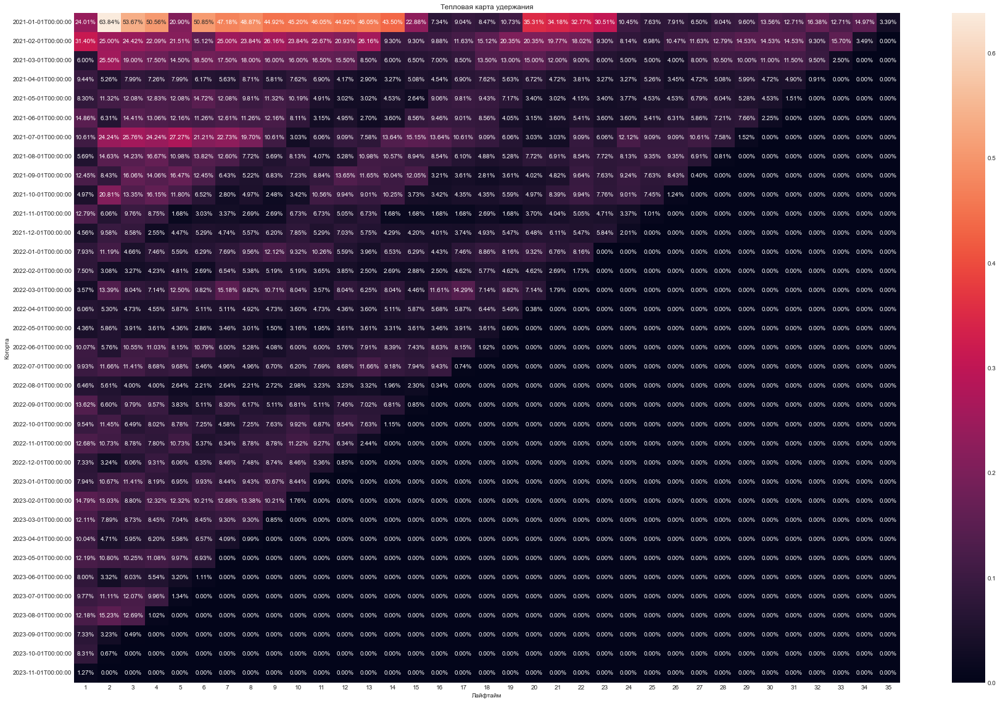

In [83]:
plt.figure(figsize=(30, 20))  # задаём размер графика
sns.heatmap(
    result_grouped.drop(columns=[0]),  # удаляем лишние столбцы
    annot=True,  # включаем подписи
    fmt='.2%'  # переводим значения в проценты
)
plt.title('Тепловая карта удержания')
plt.xlabel('Лайфтайм')
plt.ylabel('Когорта')
plt.show()

Первая когорта оказалось самой активной: довольно часто люди, впервые совершившие пожертвование в январе 2021, возвращались чтобы совершить пожертвование снова. Также хорошая активность у когорт февраля и марта 2021, а также у когорты июля 2021. (июльская когорта 2021 самая маленькая, в ней всего 66 человек)

Теперь построим таблицу выручки и посчитаем LTV.

In [84]:
# строим «треугольную» таблицу выручки
ltv = result_raw.pivot_table(index='cohort',
                             columns='lifetime_in_month',
                             values='order_sum',  # в ячейках — выручка за каждый лайфтайм
                             aggfunc='sum'
                            )

# считаем сумму выручки с накоплением
ltv = ltv.fillna(0).cumsum(axis=1)

# объединим размеры когорт и таблицу выручки
ltv = cohort_sizes.merge(ltv, on='cohort', how='left').fillna(0)

# посчитаем LTV
# делим каждую «ячейку» в строке на размер когорты
ltv = ltv.div(ltv['cohort_size'], axis=0)
# восстанавливаем размеры когорт
ltv['cohort_size'] = cohort_sizes
        
ltv

,cohort_size,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35
cohort,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01-01,354,1155.52,1389.55,2056.78,2441.73,2844.87,3021.50,3418.69,3785.17,4142.12,4439.79,4780.93,5106.22,5420.15,5782.84,6305.89,6465.70,6615.06,6757.54,6866.25,6982.77,7301.94,7572.06,7825.51,8073.76,8299.99,8457.66,8572.70,8676.57,8795.44,8899.87,9055.97,9191.26,9870.36,10030.75,10238.88,10258.93
2021-02-01,172,1000.49,1411.45,1808.66,2198.05,2319.33,3025.44,3201.31,3538.52,3710.70,3850.96,4038.75,4218.37,4400.17,4761.45,4822.53,4889.10,4940.32,5031.34,5253.55,5426.13,5708.36,6066.57,6170.31,6275.63,6486.53,6544.34,6649.59,6795.15,6918.77,7048.51,7142.94,7206.86,7255.02,7432.34,7450.94,7450.94
2021-03-01,200,1567.12,1778.62,1993.86,2207.61,2465.61,2562.70,2767.32,3020.72,3256.05,3378.32,3644.59,3795.45,4076.01,4258.77,4360.27,4408.27,4432.27,4494.33,4542.85,4581.61,4633.62,4686.64,4741.54,4781.19,4836.44,4862.19,4886.94,4929.69,5011.94,5055.19,5122.84,5199.34,5229.34,5245.34,5245.34,5245.34
2021-04-01,551,2497.62,2590.45,2675.40,2736.03,2801.66,2863.48,2921.52,2954.55,3017.62,3098.81,3144.14,3186.50,3272.11,3305.08,3344.68,3381.68,3429.01,3480.37,3553.70,3633.44,3681.48,3752.06,3810.83,3859.92,3910.41,3988.21,4040.93,4102.32,4147.66,4230.73,4272.67,4357.28,4363.18,4363.18,4363.18,4363.18
2021-05-01,265,592.81,641.91,689.96,757.77,813.09,852.45,946.67,985.48,1016.99,1078.20,1128.12,1145.11,1156.78,1185.45,1206.58,1220.73,1306.35,1349.39,1380.17,1435.05,1463.83,1494.81,1547.71,1597.22,1652.60,1680.86,1756.42,1821.38,1879.66,1967.02,1991.59,1994.27,1994.27,1994.27,1994.27,1994.27
2021-06-01,222,518.00,553.15,597.07,651.24,683.92,850.61,888.92,992.12,1079.98,1131.58,1170.34,1183.40,1200.97,1214.48,1237.45,1265.83,1303.67,1339.52,1372.28,1391.20,1407.74,1422.83,1451.08,1463.24,1478.10,1513.33,1552.07,1584.14,1628.37,1685.04,1690.55,1690.55,1690.55,1690.55,1690.55,1690.55
2021-07-01,66,1342.32,2302.92,2479.48,2634.83,2781.09,2924.27,3050.79,3194.20,3322.68,3377.98,3443.14,3547.68,3660.56,3718.14,3852.23,3911.32,3976.85,4027.61,4165.74,4262.71,4297.56,4367.44,4481.39,4573.82,4685.18,4763.21,4847.30,4943.52,5071.55,5073.82,5073.82,5073.82,5073.82,5073.82,5073.82,5073.82
2021-08-01,246,798.72,932.26,1017.83,1115.18,1212.62,1263.55,1332.46,1387.23,1420.76,1440.63,1485.00,1514.39,1538.03,1592.75,1647.26,1687.98,1727.71,1869.38,1915.81,1938.44,2019.84,2075.73,2121.05,2202.76,2247.48,2310.48,2390.65,2431.70,2436.17,2436.17,2436.17,2436.17,2436.17,2436.17,2436.17,2436.17
2021-09-01,249,778.29,828.73,881.22,967.95,1067.65,1182.49,1242.03,1293.86,1397.31,1446.18,1477.14,1569.54,1628.39,1699.06,1792.21,2198.95,2234.59,2266.92,2279.77,2310.94,2336.47,2352.94,2437.47,2473.82,2533.26,2573.02,2617.59,2623.62,2623.62,2623.62,2623.62,2623.62,2623.62,2623.62,2623.62,2623.62


Строим тепловую карту для наглядности.

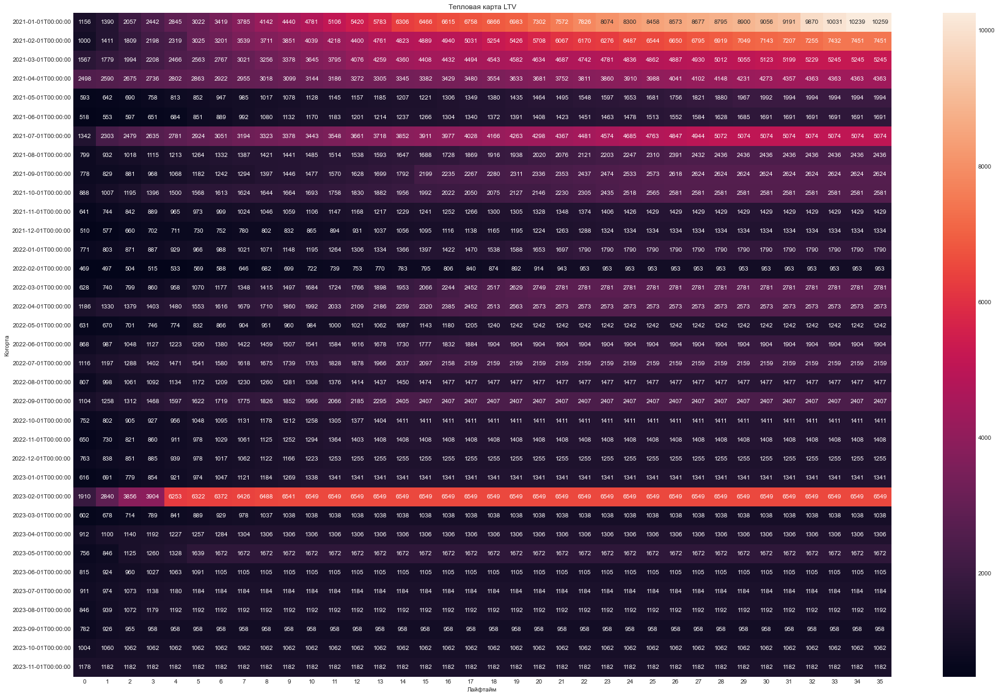

In [85]:
plt.figure(figsize=(30, 20))
sns.heatmap(ltv.drop(columns=['cohort_size']), annot=True, fmt='.0f')
plt.title('Тепловая карта LTV')
plt.xlabel('Лайфтайм')
plt.ylabel('Когорта')
plt.show()

Напомню, что LTV, или Lifetime Value, — это «пожизненная ценность» клиента, то есть общая сумма денег, которую один клиент в среднем приносит компании со всех своих покупок.

Как мы и заметили ранее, лучший показатель ценности клиентов у первой когорты (январь 2021). Также неплохо выглядят когорты: февраль-март-апрель 2021, июль 2021. А когорта февраля 2023 могла бы побить все рекорды в будущем.

### 5. Общий вывод

Мы получили таблицу с RFM сегментами.

In [86]:
rfm_stats.set_index('RFM сегмент').style.format(thousands='.', decimal=',', precision=2).bar(cmap='PuBu')

,Человек в сегменте (чел.),Количество пожертвований (ед.),Среднее пожертвование (руб.),Сумма пожертвований (руб.),Средний период активности (дней),Самое популярное пожертвование
RFM сегмент,,,,,,
111,343,661,"171,98",113.680,"268,87",На уставную деятельность
112,299,977,"412,97",403.467,"376,10",На уставную деятельность
113,136,753,"2.125,38",1.600.410,"486,89",На уставную деятельность
121,216,657,"121,22",79.641,"163,98",На уставную деятельность
122,255,1.513,"237,24",358.951,"335,34",На уставную деятельность
123,161,1.908,"1.044,56",1.993.028,"523,08",На уставную деятельность
131,5.157,5.370,"289,67",1.555.519,"1,73",На уставную деятельность
132,1.297,1.567,"991,30",1.553.365,"6,29",На уставную деятельность
133,419,822,"4.771,36",3.922.060,"109,43",На уставную деятельность


Провели когортный анализ и выяснили, что:
- Первая когорта (январь 2021) оказалось самой активной согласно Retention Rate: довольно часто люди, впервые совершившие пожертвование в январе 2021, возвращались чтобы совершить пожертвование снова. Также хорошая активность у когорт февраля и марта 2021, а также у когорты июля 2021. (июльская когорта 2021 самая маленькая, в ней всего 66 человек);
- Лучший показатель ценности клиентов (LTV) у первой когорты (январь 2021). Также неплохо выглядят когорты: февраль-март-апрель 2021, июль 2021. А когорта февраля 2023 могла бы побить все рекорды в будущем;
- Медианное значение пожертвований в основном 300 рублей. А среднее всегда выше. Особенно выделяется когорта февраля 2023, где среднее равно довольно высокому значению 2 198 рублей;
- Самые популярные месяцы, в которые люди впервые совершали донат - это декабрь 2021, август 2022 и сентябрь 2023.